# HW4-1 & HW4-2

In [1]:
from GridBoard import *
from Gridworld import *
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import random
from matplotlib import pylab as plt
import copy
from collections import deque

### DQN & Dueling DQN Neural Network 

In [2]:
# 定義 DQN 網絡
class DQN(nn.Module):
    def __init__(self, input_size = 64, output_size = 4):
        super(DQN, self).__init__()
        self.layer1 = nn.Linear(input_size, 150)
        self.relu1 = nn.ReLU()
        self.layer2 = nn.Linear(150, 100)
        self.relu2 = nn.ReLU()
        self.layer3 = nn.Linear(100, output_size)
    
    def forward(self, x):
        x = self.layer1(x)
        x = self.relu1(x)
        x = self.layer2(x)
        x = self.relu2(x)
        return self.layer3(x)
    

class DuelingDQN(nn.Module):
    def __init__(self, input_size = 64, output_size = 4):
        super(DuelingDQN, self).__init__()

        self.layer1 = nn.Linear(input_size, 150)
        self.relu1 = nn.ReLU()
        self.layer2 = nn.Linear(150, 100)
        self.relu2 = nn.ReLU() 
        
        # 狀態價值流
        self.value_stream = nn.Linear(100, 1)
        
        # 優勢流
        self.advantage_stream = nn.Linear(100, output_size)
    
    def forward(self, x):
        x = self.layer1(x)
        x = self.relu1(x)
        x = self.layer2(x)
        x = self.relu2(x)

        value = self.value_stream(x)
        advantages = self.advantage_stream(x)
        
        # 結合價值和優勢以獲得 Q 值
        # Q(s,a) = V(s) + (A(s,a) - mean(A(s,a)))
        # 這種方式有助於提高訓練穩定性
        qvalues = value + (advantages - advantages.mean(dim=1, keepdim=True))
        
        return qvalues

### Experience Replay Buffer

In [3]:
# 經驗回放緩衝區
class ReplayBuffer:
    def __init__(self, capacity):
        self.buffer = deque(maxlen=capacity)
    
    def push(self, state, action, reward, next_state, done):
        self.buffer.append((state, action, reward, next_state, done))
    
    def sample(self, batch_size):
        return random.sample(self.buffer, batch_size)
    
    def memLen(self):
        return len(self.buffer)

### DQN Agent

In [4]:
class DQNAgent:
    def __init__(self, state_size, action_size, gamma=0.9, epsilon=1.0, 
                 epsilon_min=0.01, epsilon_decay=0.995, learning_rate=0.001, 
                 buffer_size=1000, batch_size=200, 
                 action_space = {0:'u', 1:'d', 2:'l', 3:'r'}):

        # 基本 agent config    
        self.state_size = state_size
        self.action_size = action_size
        self.gamma = gamma  # 折扣因子
        self.epsilon = epsilon  # 探索率
        self.epsilon_min = epsilon_min
        self.epsilon_decay = epsilon_decay
        self.learning_rate = learning_rate
        self.batch_size = batch_size
        self.action_space = action_space
        self.step = 0
        
        # experience reply buffer
        self.memory = ReplayBuffer(buffer_size)

        #loss 和 loss function
        self.loss = None
        self.losses = []
        self.loss_fn = torch.nn.MSELoss()
        
        # 主網絡 & 目標網路
        self.policy_net = None
        self.enableTarget_net = False
        self.target_net = None
        self.sync_freq  = 500
        self.optimizer = None


    def setAgent(self, policy_net, enable_target_net):
        if policy_net == "DQN":
            self.policy_net = DQN(self.state_size, self.action_size)
        elif policy_net == "DuelingDQN":
            self.policy_net = DuelingDQN(self.state_size, self.action_size)

        self.optimizer = torch.optim.Adam(self.policy_net.parameters(), lr=self.learning_rate)
        
        if enable_target_net:
            self.enableTarget_net = True
            self.target_net = copy.deepcopy(self.policy_net) #完整複製原始Q網路模型，產生目標網路模型
            self.target_net.load_state_dict(self.policy_net.state_dict()) #將原始Q網路中的參數複製給目標網路    

    def learn(self):
        
        if self.memory.memLen() < self.batch_size:
            return
        
        minibatch = self.memory.sample(self.batch_size) #隨機選擇replay中的資料來組成子集
        state1_batch = torch.cat([s1 for (s1,a,r,s2,d) in minibatch]) #將經驗中的不同元素分別儲存到對應的小批次張量中
        action_batch = torch.Tensor([a for (s1,a,r,s2,d) in minibatch])
        reward_batch = torch.Tensor([r for (s1,a,r,s2,d) in minibatch])
        state2_batch = torch.cat([s2 for (s1,a,r,s2,d) in minibatch]) 
        done_batch = torch.Tensor([d for (s1,a,r,s2,d) in minibatch])    

        curQval = self.policy_net(state1_batch)

        with torch.no_grad():
            if self.enableTarget_net == False:
                nextQval = self.policy_net(state2_batch)
            else:
                nextQval = self.target_net(state2_batch)

        Y = reward_batch + self.gamma * ((1 - done_batch) * torch.max(nextQval, dim=1)[0])
        X = curQval.gather(dim = 1,index = action_batch.long().unsqueeze(dim=1)).squeeze() 
        
        self.loss = self.loss_fn(X, Y.detach())
        self.optimizer.zero_grad()
        self.loss.backward()
        self.optimizer.step()
        self.losses.append(self.loss.item())  

        if self.enableTarget_net and self.step % self.sync_freq == 0: #每500步，就將Q網路當前的參數複製一份給目標網路
            self.target_net.load_state_dict(self.policy_net.state_dict())


    def trainAgent(self, episodes = 5000, max_moves = 50, gridSize = 4, gameMode = "random"):
        for episode in range(episodes):
            game = Gridworld(size = gridSize, mode = gameMode)
            
            state_ = game.board.render_np().reshape(1,64) + np.random.rand(1,64)/100.0 
            state = torch.from_numpy(state_).float()
            
            status = 1 #用來追蹤遊戲是否仍在繼續（1代表仍在繼續）
            moves = 0 #記錄移動的步數，初始化為0

            while status == 1:
                moves += 1
                self.step += 1

                Qval = self.policy_net(state) 
                Qval_ = Qval.data.numpy()
                if (random.random() < self.epsilon):
                    action_ = np.random.randint(0, self.action_size)
                else:
                    action_ = np.argmax(Qval_)    
                
                action = self.action_space[action_]
                game.makeMove(action)

                next_state_ = game.board.render_np().reshape(1,64) + np.random.rand(1,64)/100.0
                next_state = torch.from_numpy(next_state_).float()

                reward = game.reward()
                done = True if reward != -1 else False

                self.memory.push(state, action_, reward, next_state, done)

                state = next_state

                self.learn()

                if reward != -1 or moves > max_moves:
                    status = 0 
                    moves = 0

            if self.epsilon > self.epsilon_min: 
                self.epsilon *= self.epsilon_decay  #讓ε的值隨著訓練的進行而慢慢下降，直到0.1（還是要保留探索的動作
        
        self.losses = np.array(self.losses)

        return self.policy_net, self.losses

    def test_model(self, gridSize = 4, mode='random', display=True):
        self.policy_net.eval()
        i = 0
        test_game = Gridworld(size=gridSize, mode=mode) #產生一場測試遊戲
        state_ = test_game.board.render_np().reshape(1,64) + np.random.rand(1,64)/10.0
        state = torch.from_numpy(state_).float()

        if display:
            print("Initial State:")
            print(test_game.display())
        
        status = 1
        
        while(status == 1): #遊戲仍在進行
            qval = self.policy_net(state)
            qval_ = qval.data.numpy()
            action_ = np.argmax(qval_) 

            action = self.action_space[action_]
            if display:
                print('Move #: %s; Taking action: %s' % (i, action))
           
            test_game.makeMove(action)
            state_ = test_game.board.render_np().reshape(1,64) + np.random.rand(1,64)/10.0
            state = torch.from_numpy(state_).float()

            if display:
                print(test_game.display())
            
            reward = test_game.reward()
            
            if reward != -1: #代表勝利（抵達終點）或落敗（掉入陷阱）
                if reward > 0: #reward>0，代表成功抵達終點
                    status = 2 #將狀態設為2，跳出迴圈
                    if display:
                        print("Game won! Reward: %s" %reward)
                else: #掉入陷阱
                    status = 0 #將狀態設為0，跳出迴圈
                    if display:
                        print("Game LOST. Reward: %s" %reward)
            
            i += 1 #每移動一步，i就加1
            
            if (i > 15): #若移動了15步，仍未取出勝利，則一樣視為落敗
                if display:
                    print("Game lost; too many moves.")
                break    
        
        win = True if status == 2 else False
        print(win)
        self.policy_net.train()

        return win



### Basic DQN Implementation(with experience reply buffer)

Text(0, 0.5, 'Loss')

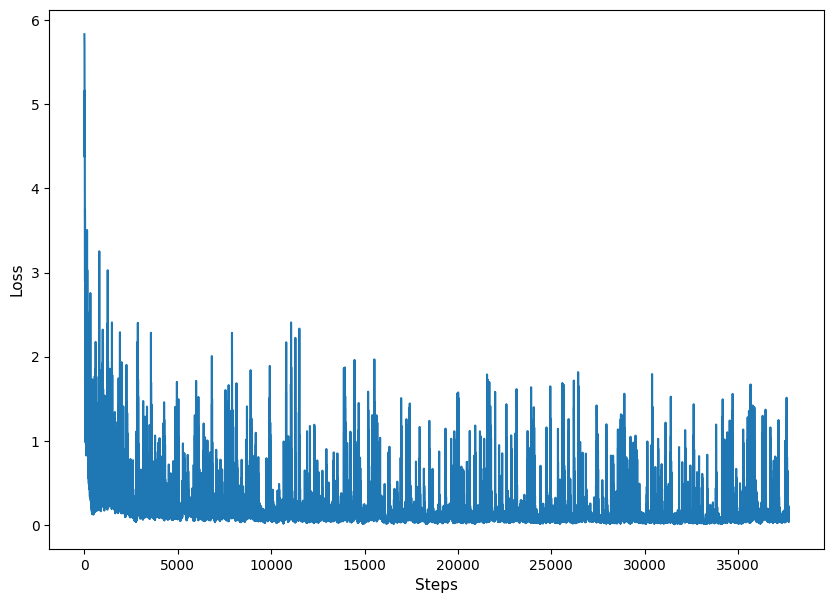

In [127]:
BasicDQN = DQNAgent(64, 4)
BasicDQN.setAgent(policy_net="DQN", enable_target_net=False)
agent1, DQN_losses = BasicDQN.trainAgent()


plt.figure(figsize=(10,7))
plt.plot(DQN_losses)
plt.xlabel("Steps",fontsize=11)
plt.ylabel("Loss",fontsize=11)


### Double DQN Implementation

Text(0, 0.5, 'Loss')

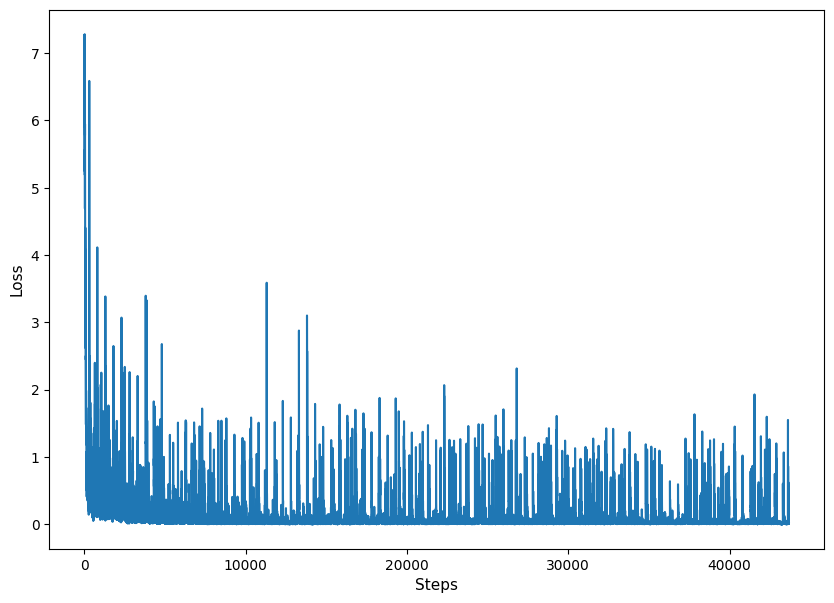

In [128]:
DoubleDQN = DQNAgent(64, 4)
DoubleDQN.setAgent(policy_net="DQN", enable_target_net=True)
agent2, DoubleDQN_losses = DoubleDQN.trainAgent()


plt.figure(figsize=(10,7))
plt.plot(DoubleDQN_losses)
plt.xlabel("Steps",fontsize=11)
plt.ylabel("Loss",fontsize=11)


### Dueling DQN Implementation

Text(0, 0.5, 'Loss')

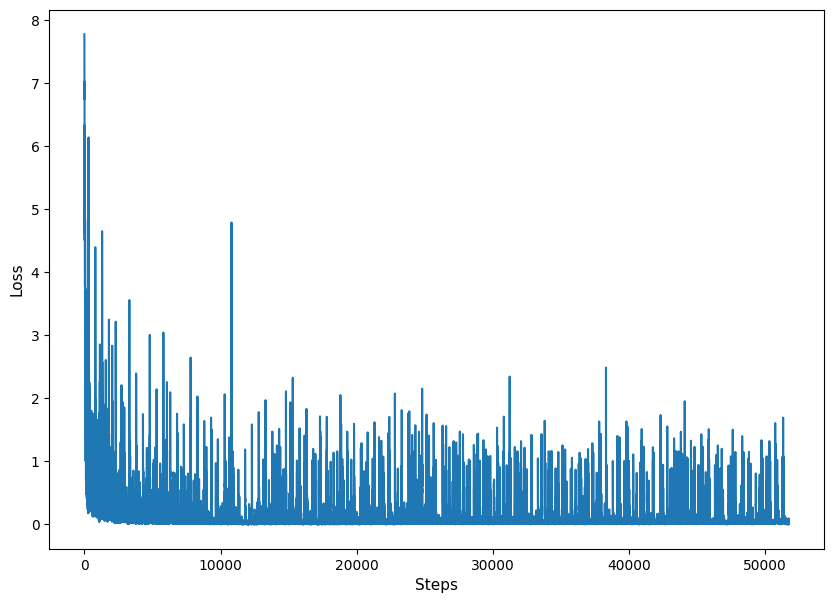

In [129]:
Dueling_DQN = DQNAgent(64, 4) #改變數名稱，避免與類別名稱 DuelingDQN 衝突

Dueling_DQN.setAgent(policy_net="DuelingDQN", enable_target_net=True)

agent3, Dueling_DQN_losses = Dueling_DQN.trainAgent()


plt.figure(figsize=(10,7))
plt.plot(Dueling_DQN_losses)
plt.xlabel("Steps",fontsize=11)
plt.ylabel("Loss",fontsize=11)


### Plot Comparison of 3 models

C:\Users\user\AppData\Local\Temp\ipykernel_24308\3858799301.py:5: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax[0].legend()
C:\Users\user\AppData\Local\Temp\ipykernel_24308\3858799301.py:12: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax[1].legend()
C:\Users\user\AppData\Local\Temp\ipykernel_24308\3858799301.py:19: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax[2].legend()


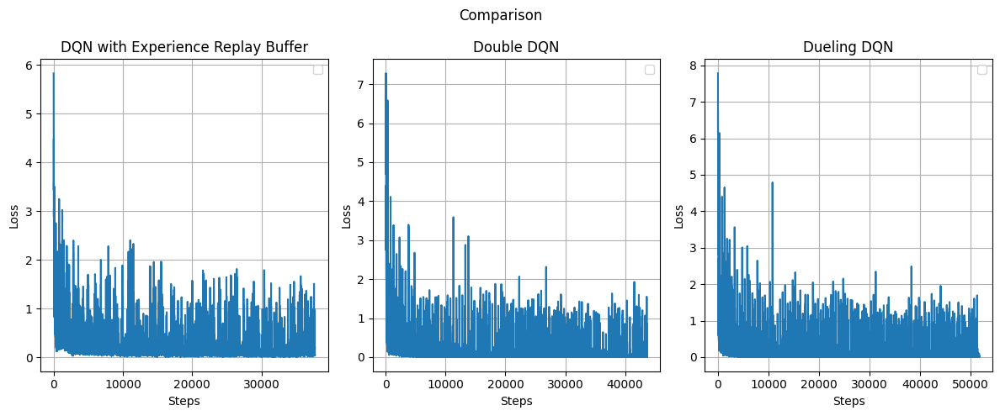

In [130]:
fig, ax = plt.subplots(1, 3, figsize=(12, 5))
ax[0].plot(DQN_losses)
ax[0].set_title("DQN with Experience Replay Buffer")
ax[0].grid(True)
ax[0].legend()
ax[0].set_xlabel("Steps")
ax[0].set_ylabel("Loss")

ax[1].plot(DoubleDQN_losses)
ax[1].set_title("Double DQN")
ax[1].grid(True)
ax[1].legend()
ax[1].set_xlabel("Steps")
ax[1].set_ylabel("Loss")

ax[2].plot(Dueling_DQN_losses)
ax[2].set_title("Dueling DQN")
ax[2].grid(True)
ax[2].legend()
ax[2].set_xlabel("Steps")
ax[2].set_ylabel("Loss")


plt.suptitle("Comparison")
plt.tight_layout()
plt.show()

### Testing winning rate of 3 models

In [ ]:
max_games = 1000

agent_wins = [0, 0, 0]


for i in range(max_games):
    win = BasicDQN.test_model()
    if win:
      agent_wins[0] += 1
win_perc = float(agent_wins[0]) / float(max_games)
print(f"Games played: {max_games}, # of wins: {agent_wins[0]}")
print(f"Win percentage: {100.0*win_perc}%") #顯示勝率


Initial State:
[[' ' ' ' '+' ' ']
 ['W' ' ' ' ' ' ']
 ['-' ' ' ' ' 'P']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: u
[[' ' ' ' '+' ' ']
 ['W' ' ' ' ' 'P']
 ['-' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: u
[[' ' ' ' '+' 'P']
 ['W' ' ' ' ' ' ']
 ['-' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 2; Taking action: l
[[' ' ' ' '+' ' ']
 ['W' ' ' ' ' ' ']
 ['-' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Game won! Reward: 10
True
Initial State:
[['P' ' ' '-' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' '+' ' ' ' ']]
Move #: 0; Taking action: d
[[' ' ' ' '-' ' ']
 ['P' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' '+' ' ' ' ']]
Move #: 1; Taking action: d
[[' ' ' ' '-' ' ']
 [' ' 'W' ' ' ' ']
 ['P' ' ' ' ' ' ']
 [' ' '+' ' ' ' ']]
Move #: 2; Taking action: d
[[' ' ' ' '-' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 ['P' '+' ' ' ' ']]
Move #: 3; Taking action: r
[[' ' ' ' '-' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' '+' ' ' ' ']]
Game won! Reward: 10
True
Initial State:
[['+' ' ' ' ' 

In [148]:
for i in range(max_games):
    win = BasicDQN.test_model()
    if win:
      agent_wins[1] += 1
win_perc = float(agent_wins[1]) / float(max_games)
print(f"Games played: {max_games}, # of wins: {agent_wins[1]}")
print(f"Win percentage: {100.0*win_perc}%") #顯示勝率


Initial State:
[[' ' '-' ' ' ' ']
 ['+' ' ' ' ' ' ']
 [' ' ' ' 'P' ' ']
 [' ' 'W' ' ' ' ']]
Move #: 0; Taking action: l
[[' ' '-' ' ' ' ']
 ['+' ' ' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' 'W' ' ' ' ']]
Move #: 1; Taking action: l
[[' ' '-' ' ' ' ']
 ['+' ' ' ' ' ' ']
 ['P' ' ' ' ' ' ']
 [' ' 'W' ' ' ' ']]
Move #: 2; Taking action: u
[[' ' '-' ' ' ' ']
 ['+' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' 'W' ' ' ' ']]
Game won! Reward: 10
True
Initial State:
[[' ' ' ' ' ' ' ']
 [' ' ' ' '-' ' ']
 [' ' ' ' 'P' ' ']
 ['W' '+' ' ' ' ']]
Move #: 0; Taking action: d
[[' ' ' ' ' ' ' ']
 [' ' ' ' '-' ' ']
 [' ' ' ' ' ' ' ']
 ['W' '+' 'P' ' ']]
Move #: 1; Taking action: l
[[' ' ' ' ' ' ' ']
 [' ' ' ' '-' ' ']
 [' ' ' ' ' ' ' ']
 ['W' '+' ' ' ' ']]
Game won! Reward: 10
True
Initial State:
[[' ' ' ' ' ' 'P']
 [' ' ' ' ' ' ' ']
 [' ' '-' ' ' ' ']
 ['+' 'W' ' ' ' ']]
Move #: 0; Taking action: l
[[' ' ' ' 'P' ' ']
 [' ' ' ' ' ' ' ']
 [' ' '-' ' ' ' ']
 ['+' 'W' ' ' ' ']]
Move #: 1; Taking action: d
[[' ' ' ' ' ' 

In [149]:
for i in range(max_games):
    win = BasicDQN.test_model()
    if win:
      agent_wins[2] += 1
win_perc = float(agent_wins[2]) / float(max_games)
print(f"Games played: {max_games}, # of wins: {agent_wins[2]}")
print(f"Win percentage: {100.0*win_perc}%") #顯示勝率


Initial State:
[[' ' '+' ' ' ' ']
 [' ' ' ' ' ' '-']
 [' ' ' ' 'W' ' ']
 [' ' ' ' 'P' ' ']]
Move #: 0; Taking action: l
[[' ' '+' ' ' ' ']
 [' ' ' ' ' ' '-']
 [' ' ' ' 'W' ' ']
 [' ' 'P' ' ' ' ']]
Move #: 1; Taking action: l
[[' ' '+' ' ' ' ']
 [' ' ' ' ' ' '-']
 [' ' ' ' 'W' ' ']
 ['P' ' ' ' ' ' ']]
Move #: 2; Taking action: l
[[' ' '+' ' ' ' ']
 [' ' ' ' ' ' '-']
 [' ' ' ' 'W' ' ']
 ['P' ' ' ' ' ' ']]
Move #: 3; Taking action: u
[[' ' '+' ' ' ' ']
 [' ' ' ' ' ' '-']
 ['P' ' ' 'W' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 4; Taking action: u
[[' ' '+' ' ' ' ']
 ['P' ' ' ' ' '-']
 [' ' ' ' 'W' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 5; Taking action: r
[[' ' '+' ' ' ' ']
 [' ' 'P' ' ' '-']
 [' ' ' ' 'W' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 6; Taking action: u
[[' ' '+' ' ' ' ']
 [' ' ' ' ' ' '-']
 [' ' ' ' 'W' ' ']
 [' ' ' ' ' ' ' ']]
Game won! Reward: 10
True
Initial State:
[[' ' 'W' ' ' ' ']
 ['+' ' ' ' ' ' ']
 [' ' '-' ' ' 'P']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: l
[[' ' 'W' ' ' ' ']
 ['+' ' 

# HW 4-3

In [5]:
import pytorch_lightning as pl
from torch.utils.data import DataLoader, TensorDataset

c:\Users\user\AppData\Local\Programs\Python\Python39\lib\site-packages\torchvision\io\image.py:13: UserWarning: Failed to load image Python extension: Could not find module 'C:\Users\user\AppData\Local\Programs\Python\Python39\Lib\site-packages\torchvision\image.pyd' (or one of its dependencies). Try using the full path with constructor syntax.
  warn(f"Failed to load image Python extension: {e}")


### Dueling NetWork Architecture 

In [6]:
class DuelingDQN_Lightning(nn.Module):
    def __init__(self, input_size = 64, output_size = 4):
        super(DuelingDQN_Lightning, self).__init__()

        self.layer1 = nn.Linear(input_size, 128)
        self.relu1 = nn.ReLU()
        self.layer2 = nn.Linear(128, 256)
        self.relu2 = nn.ReLU()
        self.layer3 = nn.Linear(256, 128)
        self.relu3 = nn.ReLU() 
        
        # 狀態價值流
        self.value_stream = nn.Linear(128, 1)
        
        # 優勢流
        self.advantage_stream = nn.Linear(128, output_size)
    
    def forward(self, x):
        x = self.layer1(x)
        x = self.relu1(x)
        x = self.layer2(x)
        x = self.relu2(x)
        x = self.layer3(x)
        x = self.relu3(x)

        value = self.value_stream(x)
        advantages = self.advantage_stream(x)
        
        # 結合價值和優勢以獲得 Q 值
        # Q(s,a) = V(s) + (A(s,a) - mean(A(s,a)))
        # 這種方式有助於提高訓練穩定性
        qvalues = value + (advantages - advantages.mean(dim=1, keepdim=True))
        
        return qvalues

### DQN Agent with Pytorch Lightning

In [7]:
# LightningModule for Double DQN
class DQNAgent_Lightning(pl.LightningModule):
    def __init__(self, state_dim, action_dim, network, lr=0.005, gamma=0.99, tau=1e-2, buffer_size = 1500, batch_size = 250):
    
        super().__init__()
        self.save_hyperparameters()
        self.lr = lr
        self.state_dim = state_dim
        self.action_dim = action_dim        
        self.action_space = {0:'u', 1:'d', 2:'l', 3:'r'}
        self.epsilon = 1.0
        self.epsilon_decay = 0.9995
        self.gamma = gamma
        self.max_moves = 50
        self.sync_freq = 800

        self.step = 0

        self.buffer = ReplayBuffer(buffer_size)
        self.batch_size = batch_size

        self.losses = []
        self.loss_fn = torch.nn.MSELoss()

        if network == "DuelingDQN" :
            self.policy_net = DuelingDQN_Lightning(state_dim, action_dim)
        else :
            self.policy_net = DQN(state_dim, action_dim)
        
        self.target_net = copy.deepcopy(self.policy_net)
        self.target_net.load_state_dict(self.policy_net.state_dict())

            # Freeze target network parameters
        for param in self.target_net.parameters():
            param.requires_grad = False

    def forward(self, x):
        return self.policy_net(x)



    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.policy_net.parameters(), lr = self.lr)
        scheduler = torch.optim.lr_scheduler.StepLR(
            optimizer,
            step_size = 500,
            gamma = 0.851
        )
        return {
            'optimizer': optimizer,
            'lr_scheduler': {
                'scheduler': scheduler,
                'interval': 'epoch',
                'frequency': 1
            }
        }
    


    def training_step(self, batch, batch_idx):
        game = Gridworld(size = 4, mode = "random")
        state_ = game.board.render_np().reshape(1,64) + np.random.rand(1,64)/100.0 
        state = torch.from_numpy(state_).float()
        
        status = 1 
        moves = 0 
        loss = None

        move_pos = [(-1,0), (1,0), (0,-1), (0,1)]
        
        while status == 1:
            moves += 1
            self.step += 1

            Qval = self.policy_net(state) 
            Qval_ = Qval.data.numpy()

            if (random.random() < self.epsilon):
                action_ = np.random.randint(0, 4)
            else:
                action_ = np.argmax(Qval_)   


            hit_wall = game.validateMove('Player', move_pos[action_]) == 1 
            
            action = self.action_space[action_]

            game.makeMove(action)

            next_state_ = game.board.render_np().reshape(1,64) + np.random.rand(1,64)/100.0
            next_state = torch.from_numpy(next_state_).float()

            #reward = game.reward()

            reward = -10 if hit_wall else game.reward()

            done = True if reward != -1 else False

            self.buffer.push(state, action_, reward, next_state, done)

            state = next_state

            # Experience replay
            if self.buffer.memLen() > self.batch_size:
                minibatch = self.buffer.sample(self.batch_size)
                state1_batch = torch.cat([s1 for (s1,a,r,s2,d) in minibatch])
                action_batch = torch.tensor([a for (s1,a,r,s2,d) in minibatch])
                reward_batch = torch.tensor([r for (s1,a,r,s2,d) in minibatch], dtype=torch.float32)
                state2_batch = torch.cat([s2 for (s1,a,r,s2,d) in minibatch])
                done_batch = torch.tensor([d for (s1,a,r,s2,d) in minibatch], dtype=torch.float32)
                
                curQ = self.policy_net(state1_batch)

                with torch.no_grad():
                    nextQ = self.target_net(state2_batch)

            
                Y = reward_batch + self.gamma * ((1 - done_batch) * torch.max(nextQ, dim=1)[0])
                X = curQ.gather(dim=1, index=action_batch.long().unsqueeze(dim=1)).squeeze()
                
                loss = self.loss_fn(X, Y.detach())
                self.losses.append(loss.item())
                

                self.log('train_loss', loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
                
                # Update target network periodically
                if self.step % self.sync_freq == 0:
                    self.target_net.load_state_dict(self.policy_net.state_dict())

            if reward != -1 or moves > self.max_moves:
                status = 0 
                moves = 0       

        if self.epsilon > 0.1:
             self.epsilon -= 1/5000
         
        return loss

    def train_dataloader(self):
        # Dummy DataLoader to satisfy Lightning, batch is not used
        dummy = torch.zeros(1)
        return DataLoader(TensorDataset(dummy), batch_size=1)
    

    def test_model(self, mode='random', display=True):
        i = 0
        test_game = Gridworld(size=4, mode=mode)
        state_ = test_game.board.render_np().reshape(1, 64) + np.random.rand(1, 64)/10.0
        state = torch.from_numpy(state_).float()

        action_set = {0:'u', 1:'d', 2:'l', 3:'r'}

        if display:
            print("Initial State:")
            print(test_game.display())
        status = 1
        while(status == 1):
            qval = self.policy_net(state)
            qval_ = qval.data.numpy()
            action_ = np.argmax(qval_) 
            action = action_set[action_]
            if display:
                print('Move #: %s; Taking action: %s' % (i, action))
            test_game.makeMove(action)
            state_ = test_game.board.render_np().reshape(1, 64) + np.random.rand(1, 64)/10.0
            state = torch.from_numpy(state_).float()
            if display:
                print(test_game.display())
            reward = test_game.reward()
            if reward != -1:
                if reward > 0:
                    status = 2
                    if display:
                        print("Game won! Reward: %s" % reward)
                else:
                    status = 0
                    if display:
                        print("Game LOST. Reward: %s" % reward)
            i += 1
            if (i >15):
                if display:
                    print("Game lost; too many moves.")
                break    
        
        win = True if status == 2 else False
        
        return win


### Double DQN Agent Implementation with Pytorch Lightning

In [8]:
model = DQNAgent_Lightning(64, 4, "DuelingDQN")
trainer = pl.Trainer(max_epochs=5000, 
                     enable_checkpointing=False, 
                     logger=False, 
                     enable_progress_bar=True, 
                     log_every_n_steps=100, 
                     gradient_clip_val=0.9             
                     )
trainer.fit(model)

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs

  | Name       | Type                 | Params | Mode 
------------------------------------------------------------
0 | loss_fn    | MSELoss              | 0      | train
1 | policy_net | DuelingDQN_Lightning | 74.9 K | train
2 | target_net | DuelingDQN_Lightning | 74.9 K | train
------------------------------------------------------------
74.9 K    Trainable params
74.9 K    Non-trainable params
149 K     Total params
0.599     Total estimated model params size (MB)
19        Modules in train mode
0         Modules in eval mode
c:\Users\user\AppData\Local\Programs\Python\Python39\lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=15` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

c:\Users\user\AppData\Local\Programs\Python\Python39\lib\site-packages\pytorch_lightning\loops\optimization\automatic.py:134: `training_step` returned `None`. If this was on purpose, ignore this warning...
c:\Users\user\AppData\Local\Programs\Python\Python39\lib\site-packages\pytorch_lightning\core\module.py:512: You called `self.log('train_loss', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
`Trainer.fit` stopped: `max_epochs=5000` reached.


### Plot of Loss Value

Text(0, 0.5, 'Loss')

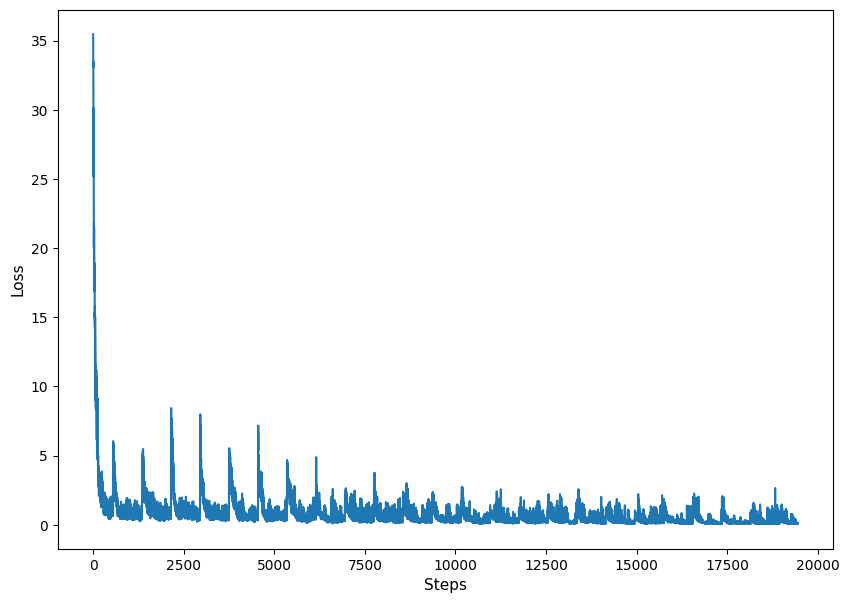

In [9]:
plt.figure(figsize=(10,7))
plt.plot(model.losses)
plt.xlabel("Steps",fontsize=11)
plt.ylabel("Loss",fontsize=11)

### Testing winning rate of Agent

In [10]:
max_games = 1000
wins = 0

for i in range(max_games):
    win = model.test_model()
    if win:
      wins += 1
win_perc = float(wins) / float(max_games)
print(f"Games played: {max_games}, # of wins: {wins}")
print(f"Win percentage: {100.0*win_perc}%") #顯示勝率

Initial State:
[[' ' 'P' ' ' ' ']
 ['W' ' ' ' ' '+']
 [' ' '-' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: r
[[' ' ' ' 'P' ' ']
 ['W' ' ' ' ' '+']
 [' ' '-' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: r
[[' ' ' ' ' ' 'P']
 ['W' ' ' ' ' '+']
 [' ' '-' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 2; Taking action: d
[[' ' ' ' ' ' ' ']
 ['W' ' ' ' ' '+']
 [' ' '-' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Game won! Reward: 10
Initial State:
[['+' '-' ' ' 'P']
 [' ' ' ' ' ' ' ']
 [' ' ' ' 'W' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: l
[['+' '-' 'P' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' 'W' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: l
[['+' '-' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' 'W' ' ']
 [' ' ' ' ' ' ' ']]
Game LOST. Reward: -10
Initial State:
[[' ' ' ' ' ' ' ']
 ['-' ' ' ' ' ' ']
 ['W' ' ' ' ' ' ']
 ['+' ' ' 'P' ' ']]
Move #: 0; Taking action: l
[[' ' ' ' ' ' ' ']
 ['-' ' ' ' ' ' ']
 ['W' ' ' ' ' ' ']
 ['+' 'P' ' ' ' ']]
Move #: 1; Taking action: l
[[' ' ' ' ' ' ' ']
 ['